In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
import networkx as nx
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import accuracy_score, silhouette_score
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from imblearn.over_sampling import SMOTE
import chess
import chess.pgn


In [17]:
data = pd.read_csv('data/games.csv')

In [8]:
data.moves

0        d4 d5 c4 c6 cxd5 e6 dxe6 fxe6 Nf3 Bb4+ Nc3 Ba5...
1        d4 Nc6 e4 e5 f4 f6 dxe5 fxe5 fxe5 Nxe5 Qd4 Nc6...
2        e4 e5 d3 d6 Be3 c6 Be2 b5 Nd2 a5 a4 c5 axb5 Nc...
3        d4 d5 Nf3 Bf5 Nc3 Nf6 Bf4 Ng4 e3 Nc6 Be2 Qd7 O...
4        e4 e5 Nf3 d6 d4 Nc6 d5 Nb4 a3 Na6 Nc3 Be7 b4 N...
                               ...                        
20053    d4 f5 e3 e6 Nf3 Nf6 Nc3 b6 Be2 Bb7 O-O Be7 Ne5...
20054    d4 d6 Bf4 e5 Bg3 Nf6 e3 exd4 exd4 d5 c3 Bd6 Bd...
20055    d4 d5 Bf4 Nc6 e3 Nf6 c3 e6 Nf3 Be7 Bd3 O-O Nbd...
20056    e4 d6 d4 Nf6 e5 dxe5 dxe5 Qxd1+ Kxd1 Nd5 c4 Nb...
20057    d4 d5 Bf4 Na6 e3 e6 c3 Nf6 Nf3 Bd7 Nbd2 b5 Bd3...
Name: moves, Length: 20058, dtype: object

In [6]:
data.head().moves


0    d4 d5 c4 c6 cxd5 e6 dxe6 fxe6 Nf3 Bb4+ Nc3 Ba5...
1    d4 Nc6 e4 e5 f4 f6 dxe5 fxe5 fxe5 Nxe5 Qd4 Nc6...
2    e4 e5 d3 d6 Be3 c6 Be2 b5 Nd2 a5 a4 c5 axb5 Nc...
3    d4 d5 Nf3 Bf5 Nc3 Nf6 Bf4 Ng4 e3 Nc6 Be2 Qd7 O...
4    e4 e5 Nf3 d6 d4 Nc6 d5 Nb4 a3 Na6 Nc3 Be7 b4 N...
Name: moves, dtype: object

d4
d5
c4
c6
cxd5
e6
dxe6
fxe6
Nf3
Bb4+
Nc3
Ba5
Bf4
----
d4
Nc6
e4
e5
f4
f6
dxe5
fxe5
fxe5
Nxe5
Qd4
Nc6
Qe5+
Nxe5
c4
Bb4+
----
e4
e5
d3
d6
Be3
c6
Be2
b5
Nd2
a5
a4
c5
axb5
Nc6
bxc6
Ra6
Nc4
a4
c3
a3
Nxa3
Rxa3
Rxa3
c4
dxc4
d5
cxd5
Qxd5
exd5
Be6
Ra8+
Ke7
Bc5+
Kf6
Bxf8
Kg6
Bxg7
Kxg7
dxe6
Kh6
exf7
Nf6
Rxh8
Nh5
Bxh5
Kg5
Rxh7
Kf5
Qf3+
Ke6
Bg4+
Kd6
Rh6+
Kc5
Qe3+
Kb5
c4+
Kb4
Qc3+
Ka4
Bd1#
----
d4
d5
Nf3
Bf5
Nc3
Nf6
Bf4
Ng4
e3
Nc6
Be2
Qd7
O-O
O-O-O
Nb5
Nb4
Rc1
Nxa2
Ra1
Nb4
Nxa7+
Kb8
Nb5
Bxc2
Bxc7+
Kc8
Qd2
Qc6
Na7+
Kd7
Nxc6
bxc6
Bxd8
Kxd8
Qxb4
e5
Qb8+
Ke7
dxe5
Be4
Ra7+
Ke6
Qe8+
Kf5
Qxf7+
Nf6
Nh4+
Kg5
g3
Ng4
Qf4+
Kh5
Qxg4+
Kh6
Qf4+
g5
Qf6+
Bg6
Nxg6
Bg7
Qxg7#
----
e4
e5
Nf3
d6
d4
Nc6
d5
Nb4
a3
Na6
Nc3
Be7
b4
Nf6
Bg5
O-O
b5
Nc5
Bxf6
Bxf6
Bd3
Qd7
O-O
Nxd3
Qxd3
c6
a4
cxd5
Nxd5
Qe6
Nc7
Qg4
Nxa8
Bd7
Nc7
Rc8
Nd5
Qg6
Nxf6+
Qxf6
Rfd1
Re8
Qxd6
Bg4
Qxf6
gxf6
Rd3
Bxf3
Rxf3
Rd8
Rxf6
Kg7
Rf3
Rd2
Rg3+
Kf8
c3
Re2
f3
Rc2
Rg5
f6
Rh5
Kg7
Rd1
Kg6
Rh3
Rxc3
Rd7
Rc1+
Kf2
Rc2+
Kg3
h5
Rxb7
Kg5
Rxa7
h4+
Rxh4
Rxg2+
Kxg2
Kxh4


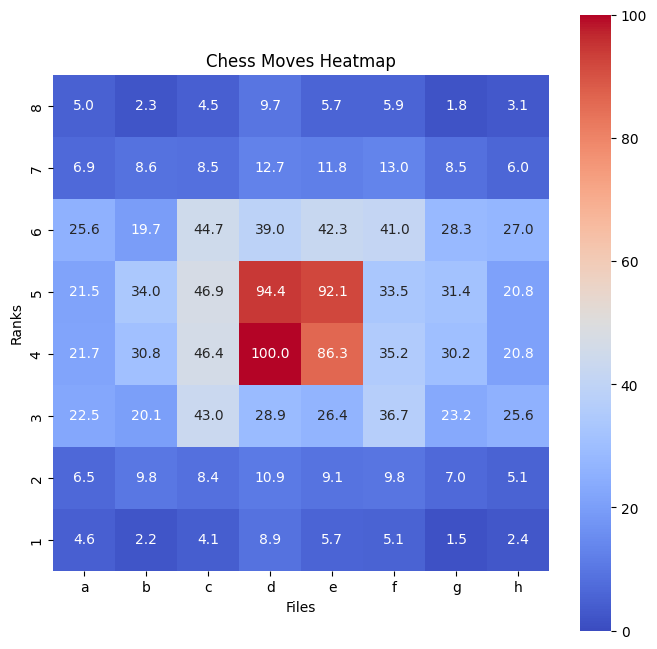

In [19]:
def move_to_coords(move):
    """Convert chess move (e.g., 'd4') to board coordinates (row, col)."""
    square = chess.SQUARE_NAMES.index(move.lower())
    row = 7 - (square // 8)
    col = square % 8
    return (row, col)

# Initialize an 8x8 matrix for the heatmap
heatmap = np.zeros((8, 8))


# Iterate through each row of moves
for move_sequence in data['moves']:
    # Split the moves in the string by spaces
    individual_moves = move_sequence.split()
    
    for move in individual_moves:
        print(move)
        # Handle captures ('x') and checks ('+')
        if 'x' in move:
            move = move.split('x')[1]  # Get the destination square
        move = move.replace('+', '')   # Remove check symbol
        
        # Convert move to coordinates and update heatmap
        if move in chess.SQUARE_NAMES:
            row, col = move_to_coords(move)
            heatmap[row, col] += 1
    print("----")
# Normalize heatmap to a 0-100 scale
heatmap = (heatmap / heatmap.max()) * 100

# Plotting the heatmap
plt.figure(figsize=(8, 8))
sns.heatmap(heatmap, annot=True, fmt=".1f", cmap='coolwarm', square=True, cbar=True, vmin=0, vmax=100, xticklabels='abcdefgh', yticklabels=range(8, 0, -1))
plt.title('Chess Moves Heatmap')
plt.xlabel('Files')
plt.ylabel('Ranks')
plt.show()

d4
d5
c4
c6
cxd5
e6
dxe6
fxe6
Nf3
Bb4+
Nc3
Ba5
Bf4
d4
Nc6
e4
e5
f4
f6
dxe5
fxe5
fxe5
Nxe5
Qd4
Nc6
Qe5+
Nxe5
c4
Bb4+
e4
e5
d3
d6
Be3
c6
Be2
b5
Nd2
a5
a4
c5
axb5
Nc6
bxc6
Ra6
Nc4
a4
c3
a3
Nxa3
Rxa3
Rxa3
c4
dxc4
d5
cxd5
Qxd5
exd5
Be6
Ra8+
Ke7
Bc5+
Kf6
Bxf8
Kg6
Bxg7
Kxg7
dxe6
Kh6
exf7
Nf6
Rxh8
Nh5
Bxh5
Kg5
Rxh7
Kf5
Qf3+
Ke6
Bg4+
Kd6
Rh6+
Kc5
Qe3+
Kb5
c4+
Kb4
Qc3+
Ka4
Bd1#
d4
d5
Nf3
Bf5
Nc3
Nf6
Bf4
Ng4
e3
Nc6
Be2
Qd7
O-O
O-O-O
Nb5
Nb4
Rc1
Nxa2
Ra1
Nb4
Nxa7+
Kb8
Nb5
Bxc2
Bxc7+
Kc8
Qd2
Qc6
Na7+
Kd7
Nxc6
bxc6
Bxd8
Kxd8
Qxb4
e5
Qb8+
Ke7
dxe5
Be4
Ra7+
Ke6
Qe8+
Kf5
Qxf7+
Nf6
Nh4+
Kg5
g3
Ng4
Qf4+
Kh5
Qxg4+
Kh6
Qf4+
g5
Qf6+
Bg6
Nxg6
Bg7
Qxg7#
e4
e5
Nf3
d6
d4
Nc6
d5
Nb4
a3
Na6
Nc3
Be7
b4
Nf6
Bg5
O-O
b5
Nc5
Bxf6
Bxf6
Bd3
Qd7
O-O
Nxd3
Qxd3
c6
a4
cxd5
Nxd5
Qe6
Nc7
Qg4
Nxa8
Bd7
Nc7
Rc8
Nd5
Qg6
Nxf6+
Qxf6
Rfd1
Re8
Qxd6
Bg4
Qxf6
gxf6
Rd3
Bxf3
Rxf3
Rd8
Rxf6
Kg7
Rf3
Rd2
Rg3+
Kf8
c3
Re2
f3
Rc2
Rg5
f6
Rh5
Kg7
Rd1
Kg6
Rh3
Rxc3
Rd7
Rc1+
Kf2
Rc2+
Kg3
h5
Rxb7
Kg5
Rxa7
h4+
Rxh4
Rxg2+
Kxg2
Kxh4
b6
Kg5
b7
f5
exf5
Kx

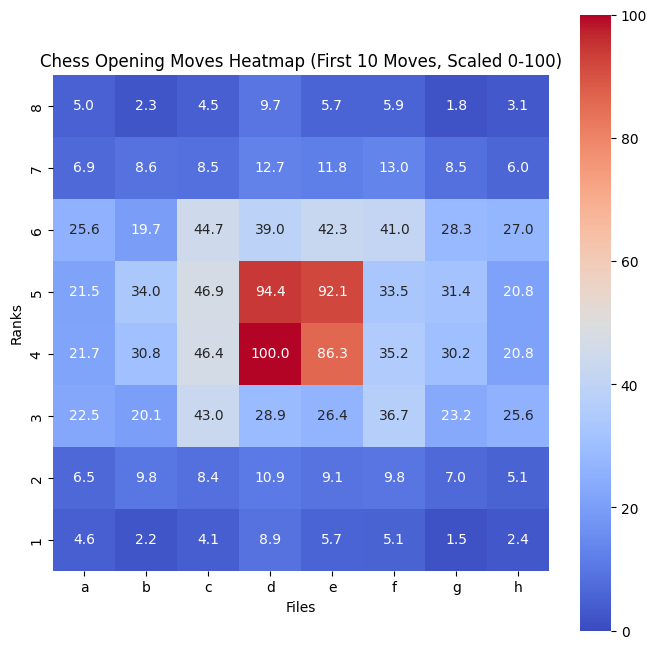

In [21]:
def move_to_coords(move):
    """Convert chess move (e.g., 'd4') to board coordinates (row, col)."""
    square = chess.SQUARE_NAMES.index(move.lower())
    row = 7 - (square // 8)
    col = square % 8
    return (row, col)

# Initialize an 8x8 matrix for the heatmap
heatmap = np.zeros((8, 8))

# Counter for moves processed
move_count = 0

# Iterate through each row of moves
for move_sequence in data['moves']:
    # Split the moves in the string by spaces
    individual_moves = move_sequence.split()
    
    for i, move in enumerate(individual_moves):
        print(move)
        if move_count >= 10:
            break  # Stop after processing 10 moves
        
        # Handle captures ('x') and checks ('+')
        if 'x' in move:
            move = move.split('x')[1]  # Get the destination square
        move = move.replace('+', '')   # Remove check symbol
        
        # Convert move to coordinates and update heatmap
        if move in chess.SQUARE_NAMES:
            row, col = move_to_coords(move)
            heatmap[row, col] += 1
        
        if i >= 10:
            break  # Stop after processing 10 moves

# Normalize heatmap to a 0-100 scale
heatmap = (heatmap / heatmap.max()) * 100

# Plotting the heatmap
plt.figure(figsize=(8, 8))
sns.heatmap(heatmap, annot=True, fmt=".1f", cmap='coolwarm', square=True, cbar=True, vmin=0, vmax=100, xticklabels='abcdefgh', yticklabels=range(8, 0, -1))
plt.title('Chess Opening Moves Heatmap (First 10 Moves, Scaled 0-100)')
plt.xlabel('Files')
plt.ylabel('Ranks')
plt.show()